In [1]:
pip install osmnx

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install folium matplotlib mapclassify

Note: you may need to restart the kernel to use updated packages.


In [3]:
import osmnx as ox
import networkx as nx
import geopandas as gpd
import folium
import time
import copy
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import numpy as np

In [4]:
place_name = "Alto Selva Alegre, Arequipa, Perú"
G = ox.graph_from_place(place_name, network_type="walk")

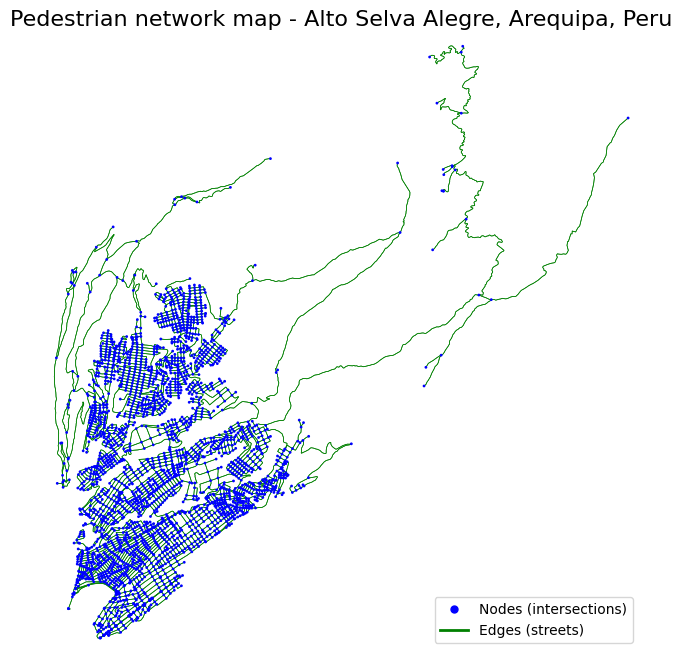

In [5]:
# Graficar el grafo y obtener los ejes
fig, ax = ox.plot_graph(
    G,
    node_size=4,
    node_color="blue",
    edge_color="green",         # Color de las aristas
    edge_linewidth=0.5,        # Ancho de las aristas
    bgcolor="white",
    show=False,  # No mostrar inmediatamente
    close=False  # No cerrar automáticamente
)

# Agregar un título al gráfico
ax.set_title("Pedestrian network map - Alto Selva Alegre, Arequipa, Peru", fontsize=16)

# Crear elementos para la leyenda
legend_elements = [
    Line2D([0], [0], color="blue", marker='o', markersize=5, linestyle="None", label="Nodes (intersections)"),
    Line2D([0], [0], color="green", linewidth=2, label="Edges (streets)")
]

# Agregar la leyenda al gráfico
ax.legend(handles=legend_elements, loc="lower right", fontsize=10, frameon=True, facecolor="white")

# Mostrar el gráfico
plt.show()

In [6]:
# Obtener el número de nodos en el grafo
num_nodos = G.number_of_nodes()
print(f"Cantidad de nodos en el grafo: {num_nodos}")

Cantidad de nodos en el grafo: 3031


In [7]:
# Convertir el grafo en GeoDataFrames
nodes_gdf, edges_gdf = ox.graph_to_gdfs(G)

# Crear un mapa base
map = nodes_gdf.explore(color="blue", marker_kwds={"radius": 4}, name="Nodos")

# Añadir las aristas al mismo mapa
edges_gdf.explore(m=map, color="green", name="Aristas")

# Añadir un control de capas
folium.LayerControl().add_to(map)

# Crear un cuadro de texto HTML para la leyenda
legend_html = """
<div style="
    position: fixed; 
    bottom: 20px; right: 20px; width: 250px; height: 90px; 
    background-color: white; border:2px solid grey; z-index:9999; font-size:14px;
    padding: 10px; border-radius: 8px; box-shadow: 3px 3px 5px rgba(0,0,0,0.4);
">
    <b>Map Legend</b><br>
    <i style="background:blue; width:10px; height:10px; display:inline-block;"></i>
    <span> Nodes (intersections)</span><br>
    <i style="background:green; width:10px; height:10px; display:inline-block;"></i>
    <span> Edges (streets)</span><br>
    
</div>
"""

# Añadir la leyenda al mapa
map.get_root().html.add_child(folium.Element(legend_html))

# Mostrar el mapa interactivo
map

In [8]:
# Extraer las coordenadas de los nodos
coords = nodes_gdf[["x", "y"]].values

# Aplicar KMeans
num_communities = 70  # Número deseado de comunidades
kmeans = KMeans(n_clusters=num_communities, random_state=42)
nodes_gdf["communities"] = kmeans.fit_predict(coords)

# Crear un mapa base con colores por comunidad
colors = [
    "red", "blue", "green", "purple", "orange", 
    "yellow", "pink", "brown", "gray", "cyan",
    "magenta", "lime", "teal", "olive", "navy",
    "maroon", "aqua", "gold", "silver", "indigo"
]
nodes_gdf["color"] = nodes_gdf["communities"].map(lambda c: colors[c % len(colors)])

# Crear el mapa base
map_communities = nodes_gdf.explore(color="color", marker_kwds={"radius": 5, "fill_opacity": 0, "stroke": False}, name="Nodos por Comunidad")

# Añadir las aristas al mapa
edges_gdf.explore(m=map_communities, color="black", name="Aristas")

# Añadir un control de capas
folium.LayerControl().add_to(map_communities)

# Mostrar el mapa interactivo
map_communities

In [9]:
# OBJETIVO: Calcular el tiempo que demora ubicar la distancia caminada de cada nodo a su respectivo centroide. 
# Comparando los algoritmos de Dijkstra, BFS y A*

# Calculando los centroides de cada comunidad (KMeans)
centroids = kmeans.cluster_centers_

# Convertir las coordenadas de los centroides (de [lat, lon]) a las coordenadas de los nodos en el grafo
centroid_nodes = []
for centroid in centroids:
    # centroid es [x, y], donde x es longitud y y es latitud
    closest_node = ox.nearest_nodes(G, centroid[0], centroid[1])
    print(closest_node)
    centroid_nodes.append(closest_node)

5393417113
5565797790
5393529479
5483281361
5405666213
5432020559
5565798223
5411367225
4409062532
5489091638
1264368320
11014439601
5432020402
5520504392
1264336430
1264286034
5411385642
5434340167
9874862944
5405647671
5465572962
1264297569
4073426321
6495369689
5489433497
5483329944
5483280828
4792987444
4744084014
4179729548
5434361551
4409064428
5393139076
5375667141
4179750202
1253013537
4978456589
5515071081
5393580653
4752118526
9874758242
5523821153
5568153216
5515064721
5483329373
5515040067
4752120036
5568153153
5393451895
5375635809
5405576807
10739314459
5405601456
5515040092
5568153035
5432006010
1264301770
5375667132
5376174128
5432020605
1264337813
5483303706
4744104281
5514936810
2998896735
4742423652
3725319321
5479087239
5565797761
5411367509


In [10]:
map_centroides = copy.deepcopy(map)

for centroid in centroid_nodes:
  # Añadir los nodos al mapa
  folium.Marker(location=(nodes_gdf.loc[centroid]["y"], nodes_gdf.loc[centroid]["x"]), icon=folium.Icon(color='purple')).add_to(map_centroides)

legend_html = """
<div style="
    position: fixed; 
    bottom: 20px; right: 20px; width: 250px; height: 100px; 
    background-color: white; border:2px solid grey; z-index:9999; font-size:14px;
    padding: 10px; border-radius: 8px; box-shadow: 3px 3px 5px rgba(0,0,0,0.4);
">
    <b>Map Legend</b><br>
    <i style="background:blue; width:10px; height:10px; display:inline-block;"></i>
    <span> Nodes (intersections)</span><br>
    <i style="background:green; width:10px; height:10px; display:inline-block;"></i>
    <span> Edges (streets)</span><br>
    <i style="background:purple; width:10px; height:10px; display:inline-block;"></i>
    <span> Possible vaccination points</span><br>
    
</div>
"""

# Añadir la leyenda al mapa
map_centroides.get_root().html.add_child(folium.Element(legend_html))
map_centroides

In [11]:
def calculate_execution_time_all_centroids(function_distance, name_algorithm_distance):
    # Inicializar una lista para almacenar las distancias de cada nodo a cada centroide
    nodes_gdf[name_algorithm_distance] = None
    
    # Tiempo de ejecución
    time_start = time.time()

    # Crear una estructura para almacenar las distancias
    distances = []

    # Iterar sobre todos los nodos del grafo
    for node in nodes_gdf.index:
        # Encontrar el nodo más cercano en el grafo para las coordenadas del nodo actual
        orig_node = ox.nearest_nodes(G, nodes_gdf.loc[node, 'x'], nodes_gdf.loc[node, 'y'])
        
        # Calcular la distancia del nodo actual a todos los centroides
        for community in range(num_communities):
            # Obtener el nodo centroide de la comunidad actual
            centroid_node = centroid_nodes[community]
            dest_node = ox.nearest_nodes(G, nodes_gdf.loc[centroid_node, 'x'], nodes_gdf.loc[centroid_node, 'y'])
            
            # Calcular la distancia entre el nodo actual y el centroide
            distance = function_distance(G, orig_node, dest_node, weight='length')
            
            # Guardar la distancia
            distances.append((node, community, distance))  # Guardamos el nodo, el centroide y la distancia

    # Convertir las distancias en un DataFrame o agregar a la estructura existente
    for node, community, distance in distances:
        # Crear una columna por centroide si deseas almacenar individualmente
        column_name = f"{name_algorithm_distance}_to_centroid_{community}"
        if column_name not in nodes_gdf.columns:
            nodes_gdf[column_name] = None
        nodes_gdf.at[node, column_name] = distance

    # Calcular tiempo de ejecución
    time_end = time.time()
    time_diff = time_end - time_start
    
    print("Termino:", name_algorithm_distance)
    return time_diff


In [12]:
total_execution_time_dijkstra = []
total_execution_time_bfs = []
total_execution_time_astar = []

for i in range(3):
  # ALGORITMO DIJKSTRA
  total_execution_time_dijkstra.append(calculate_execution_time_all_centroids(nx.dijkstra_path_length, "dijkstra_algorithm_distance"))

Termino: dijkstra_algorithm_distance
Termino: dijkstra_algorithm_distance
Termino: dijkstra_algorithm_distance


In [16]:
total_execution_time_dijkstra

[3834.7453866004944, 3854.0247147083282, 3908.8004491329193]

In [18]:
for i in range(3):
  # ALGORITMO BELLMAN-FORD
  total_execution_time_bfs.append(calculate_execution_time_all_centroids(nx.bellman_ford_path_length, "bfs_algorithm_distance"))
  print(total_execution_time_bfs)

/home/pantro/Documentos/GITHUB/doutoradoCS/myenv/lib/python3.12/site-packages/geopandas/geodataframe.py:1528: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
/home/pantro/Documentos/GITHUB/doutoradoCS/myenv/lib/python3.12/site-packages/geopandas/geodataframe.py:1528: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
/home/pantro/Documentos/GITHUB/doutoradoCS/myenv/lib/python3.12/site-packages/geopandas/geodataframe.py:1528: PerformanceWarning: DataFrame is highly fragment

Termino: bfs_algorithm_distance
[15263.103897333145]
Termino: bfs_algorithm_distance
[15263.103897333145, 15000.080922842026]
Termino: bfs_algorithm_distance
[15263.103897333145, 15000.080922842026, 14510.252537965775]


In [17]:
for i in range(3):
  # ALGORITMO A*
  total_execution_time_astar.append(calculate_execution_time_all_centroids(nx.astar_path_length, "astar_algorithm_distance"))

total_execution_time_astar

/home/pantro/Documentos/GITHUB/doutoradoCS/myenv/lib/python3.12/site-packages/geopandas/geodataframe.py:1528: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
/home/pantro/Documentos/GITHUB/doutoradoCS/myenv/lib/python3.12/site-packages/geopandas/geodataframe.py:1528: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
/home/pantro/Documentos/GITHUB/doutoradoCS/myenv/lib/python3.12/site-packages/geopandas/geodataframe.py:1528: PerformanceWarning: DataFrame is highly fragment

Termino: astar_algorithm_distance
Termino: astar_algorithm_distance
Termino: astar_algorithm_distance


[3926.303285598755, 3925.749922513962, 4013.351847887039]

In [19]:
# Media y desviasion estandar
print(np.mean(total_execution_time_dijkstra))
print(np.std(total_execution_time_dijkstra))

print(np.mean(total_execution_time_astar))
print(np.std(total_execution_time_astar))

print(np.mean(total_execution_time_bfs))
print(np.std(total_execution_time_bfs))

3865.8568501472473
31.369174289994042
3955.1350186665854
41.16613459336468
14924.479119380316
311.9647595913378
